## Project Milestone 5
Merging the Data and Storing in a Database/Visualizing Data
1. Load flat file/webscrapped/API data to Database
2. load each dataset into SQL Lite as an individual table and then you must join the datasets together in Python into 1 dataset
3. Once all the data is merged together in your database, create 5 visualizations that demonstrate the data you have cleansed. You should have at least 2 visualizations that have data from more than one source (meaning, if you have 3 tables, you must have visualizations that span across 2 of the tables – you are also welcome to use your consolidated dataset that you created in the previous step, if you do that, you have met this requirement. For the visualization portion of the project, you are welcome to use a python library like Matplotlib, Seaborn, or an R package ggPlot2, Plotly, or Tableau/PowerBI.


In [5]:
# load packages
import pandas as pd
import datetime as dt
import pandas_profiling as pp
from fuzzywuzzy import fuzz
import kaggle
from kaggle.api.kaggle_api_extended import KaggleApi
import os

In [6]:
## set the working directory
os.chdir('C:/Users/Supraja/Desktop/5. DSC540/Project Submission/project_data')

## Data Source 1: Flat file data source

In [5]:
# Data Source 1 - Flat file data
car_price_data = pd.read_csv('CarPrice_Assignment.csv') 
car_price_data.head()

,car_ID,symboling,CarName,fueltype,aspiration,doornumber,carbody,drivewheel,enginelocation,wheelbase,...,enginesize,fuelsystem,boreratio,stroke,compressionratio,horsepower,peakrpm,citympg,highwaympg,price
0,1,3,alfa-romero giulia,gas,std,two,convertible,rwd,front,88.6,...,130,mpfi,3.47,2.68,9.0,111,5000,21,27,13495.0
1,2,3,alfa-romero stelvio,gas,std,two,convertible,rwd,front,88.6,...,130,mpfi,3.47,2.68,9.0,111,5000,21,27,16500.0
2,3,1,alfa-romero Quadrifoglio,gas,std,two,hatchback,rwd,front,94.5,...,152,mpfi,2.68,3.47,9.0,154,5000,19,26,16500.0
3,4,2,audi 100 ls,gas,std,four,sedan,fwd,front,99.8,...,109,mpfi,3.19,3.40,10.0,102,5500,24,30,13950.0
4,5,2,audi 100ls,gas,std,four,sedan,4wd,front,99.4,...,136,mpfi,3.19,3.40,8.0,115,5500,18,22,17450.0


# Data Source 2: Website Data

In [6]:
from bs4 import BeautifulSoup
from requests import get
import pandas as pd
import time
import random
headers = ({'User-Agent':
            'Mozilla/5.0 (Macintosh; Intel Mac OS X 10_11_6) AppleWebKit\
/537.36 (KHTML, like Gecko) Chrome/56.0.2924.87 Safari/537.36'})

def get_basic_info(content_list):
    basic_info = []
    for item in content_list:
        basic_info.append(item.find_all('div', attrs={'class': 'car-ad-info'}))
    return basic_info

def get_names(basic_info):
    names = []
    for item in basic_info:
        for i in item:
            names.append(i.find_all("h2", attrs = {"class" : "car-ad-name"})[0].text.strip())
    return names

def get_years(basic_info):
    years = []
    for item in basic_info:
        for i in item:
            years.append(i.find_all("h3", attrs = {"class" : "car-ad-year"})[0].text.strip())
    return years

def get_prices(basic_info):
    prices = []
    for item in basic_info:
        for i in item:
            prices.append(i.find_all("div", attrs = {"class" : "car-ad-price"})[0].string.replace(u'\xa0', u' ').strip())
    return prices

def get_motor(basic_info):
    tables = []
    motors = []
    mileages = []
    data = [motors, mileages]
    for item in basic_info:
        for i in item:
            tables.append(i.find_all("table", attrs = {"class" : "used-specs-table"})[0])
    for table in tables:
        motors.append(table.find("td", attrs={"class" : "car-ad-cc"}).string)
        mileages.append(table.find("td", attrs={"class" : "car-ad-km"}).string)
    return data

page_number = 2
names = []
prices = []
years = []
motors = []
mileages = []


for i in range(19):
    base_url = "https://www.carroya.com/buscar/vehiculos/t4e0.do#paginaActual={}".format(page_number)
    response = get(base_url, headers=headers)
    html_soup = BeautifulSoup(response.text, 'html.parser')
    content_list = html_soup.find_all('div', attrs={'class': 'car-ad sft-ad'})

    basic_info = get_basic_info(content_list)
    names1 = get_names(basic_info)
    prices1 = get_prices(basic_info)
    years1 = get_years(basic_info)
    motors1 = get_motor(basic_info)[0]
    mileages1 = get_motor(basic_info)[1]

    names.extend(names1)
    prices.extend(prices1)
    years.extend(years1)
    motors.extend(motors1)
    mileages.extend(mileages1)
    page_number = page_number + 1
    time.sleep(random.randint(1,2))

cols = ["Name", "Year", "Motor", "Mileage (Km)", "Price"]
data = pd.DataFrame({"Name" : names, "Year" : years, "Motor" : motors, "Mileage (Km)": mileages, "Price" : prices})[cols]
data["Price"] = data["Price"].replace({'\$ ':''}, regex = True)
data["Price"] = data["Price"].replace({'\,':''}, regex = True)
data["Mileage (Km)"] = data["Mileage (Km)"].replace({'\ Km':''}, regex = True)
data[["Mileage (Km)", "Year", "Motor", "Price"]] = data[["Mileage (Km)", "Year", "Motor", "Price"]].apply(pd.to_numeric)
print(data)



                                         Name  Year  Motor  Mileage (Km)  \
0         Mazda 3 Skyactiv Touring Sedan 2015  2015   2000        101000   
1                    Ford Mustang Gt 350 1965  1965      0         46000   
2     Mazda 3 Skyactiv Touring Sedan Aut 2019  2019   2000         33500   
3    Mazda CX-5 2.5 4x4 Automatica Grand 2020  2020   2500         24100   
4                          Chevrolet NHR 2022  2022   3000           100   
..                                        ...   ...    ...           ...   
451         Mercedes benz Clase M Ml 320 1998  1998   3200        122000   
452        Chevrolet Zafira 2.0 Mecanica 2008  2008   2000        153000   
453             Nissan Versa Advance Aut 2013  2013   1600        103500   
454                Ford Hot Rod Mecanico 1950  1950   1600         99000   
455         Peugeot 405 Sri 2.0 Mecanico 1996  1996   2000        178000   

         Price  
0     49900000  
1    150000000  
2     66900000  
3    119900000  
4 

## Data Source 3: Data Pull from API

In [7]:
api = KaggleApi()
api.authenticate()

In [8]:
api.dataset_download_file('lepchenkov/usedcarscatalog', file_name='cars.csv')

True

## Rename columns

In [9]:
##  Data Source 1 - Flat file data car price dataset first five observations
#car_price_data.head(5)
## loading csv file from local directory
# Data Source 1 - Flat file data
car_price_data = pd.read_csv('CarPrice_Assignment.csv') 
car_price_data_df=pd.DataFrame(car_price_data)
car_price_data_df.rename(columns={'car_ID': 'car_list_id'}, inplace=True)
car_price_data_df

,car_list_id,symboling,CarName,fueltype,aspiration,doornumber,carbody,drivewheel,enginelocation,wheelbase,...,enginesize,fuelsystem,boreratio,stroke,compressionratio,horsepower,peakrpm,citympg,highwaympg,price
0,1,3,alfa-romero giulia,gas,std,two,convertible,rwd,front,88.6,...,130,mpfi,3.47,2.68,9.0,111,5000,21,27,13495.0
1,2,3,alfa-romero stelvio,gas,std,two,convertible,rwd,front,88.6,...,130,mpfi,3.47,2.68,9.0,111,5000,21,27,16500.0
2,3,1,alfa-romero Quadrifoglio,gas,std,two,hatchback,rwd,front,94.5,...,152,mpfi,2.68,3.47,9.0,154,5000,19,26,16500.0
3,4,2,audi 100 ls,gas,std,four,sedan,fwd,front,99.8,...,109,mpfi,3.19,3.40,10.0,102,5500,24,30,13950.0
4,5,2,audi 100ls,gas,std,four,sedan,4wd,front,99.4,...,136,mpfi,3.19,3.40,8.0,115,5500,18,22,17450.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
200,201,-1,volvo 145e (sw),gas,std,four,sedan,rwd,front,109.1,...,141,mpfi,3.78,3.15,9.5,114,5400,23,28,16845.0
201,202,-1,volvo 144ea,gas,turbo,four,sedan,rwd,front,109.1,...,141,mpfi,3.78,3.15,8.7,160,5300,19,25,19045.0
202,203,-1,volvo 244dl,gas,std,four,sedan,rwd,front,109.1,...,173,mpfi,3.58,2.87,8.8,134,5500,18,23,21485.0
203,204,-1,volvo 246,diesel,turbo,four,sedan,rwd,front,109.1,...,145,idi,3.01,3.40,23.0,106,4800,26,27,22470.0


## Dropping Duplicates

The above indicates that the test data had no duplicated values

In [10]:
len_1 = car_price_data.shape[0]
car_price_data1 = car_price_data.drop_duplicates()
len_2 = car_price_data1.shape[0]
print(len_1, len_2)

205 205


The above indicates that the car price data had no duplicated values

## Identify Outliers 
## Bad Data 
## Format data

In [11]:
pp.ProfileReport(car_price_data_df)

## Conduct Fuzzy Matching

In the above data, row# 196 and 202 both has CarName as "volvo 244dl". Hence, they should be a 100% match

In [12]:
fuzz.partial_ratio(car_price_data_df['CarName'].values[196], car_price_data_df['CarName'].values[202])

100


On the other hand, row# 196 and 198 is having some similarity but they do not match completely

In [13]:
fuzz.partial_ratio(car_price_data_df['CarName'].values[196], car_price_data_df['CarName'].values[198])

82

In [12]:
# Pointing to website stored data from "Project Milestone 1" 
# calling dataframe "data" and creating a CSV file - transforming data to readable format.
df = pd.DataFrame(data, columns=["Name", "Mileage (Km)", "Year", "Motor", "Price"])#create DataFrame
print("Original DataFrame:")
print(df)
print('Data from website.csv:')
df.to_csv('USA_Cars_website_data.csv', sep=',', index=False,header=True)
new_df = pd.read_csv('USA_Cars_website_data.csv')
print(new_df)

Original DataFrame:
                                         Name  Mileage (Km)  Year  Motor  \
0         Mazda 3 Skyactiv Touring Sedan 2015        101000  2015   2000   
1                    Ford Mustang Gt 350 1965         46000  1965      0   
2     Mazda 3 Skyactiv Touring Sedan Aut 2019         33500  2019   2000   
3    Mazda CX-5 2.5 4x4 Automatica Grand 2020         24100  2020   2500   
4                          Chevrolet NHR 2022           100  2022   3000   
..                                        ...           ...   ...    ...   
451         Mercedes benz Clase M Ml 320 1998        122000  1998   3200   
452        Chevrolet Zafira 2.0 Mecanica 2008        153000  2008   2000   
453             Nissan Versa Advance Aut 2013        103500  2013   1600   
454                Ford Hot Rod Mecanico 1950         99000  1950   1600   
455         Peugeot 405 Sri 2.0 Mecanico 1996        178000  1996   2000   

         Price  
0     49900000  
1    150000000  
2     66900000  

In [17]:
# Rename of columns

car_price_website_data = pd.read_csv('USA_Cars_website_data.csv') 
car_price_website_data_df=pd.DataFrame(car_price_website_data)
car_price_website_data_df.rename(columns={'Motor': 'Engine_Capacity'}, inplace=True)
car_price_website_data_df.rename(columns={'Mileage (Km)': 'Mileage'}, inplace=True)
car_price_website_data_df.rename(columns={'Name': 'Car Model'}, inplace=True)
car_price_website_data_df

,Car Model,Mileage,Year,Engine_Capacity,Price
0,Mazda 3 Skyactiv Touring Sedan 2015,101000,2015,2000,49900000
1,Ford Mustang Gt 350 1965,46000,1965,0,150000000
2,Mazda 3 Skyactiv Touring Sedan Aut 2019,33500,2019,2000,66900000
3,Mazda CX-5 2.5 4x4 Automatica Grand 2020,24100,2020,2500,119900000
4,Chevrolet NHR 2022,100,2022,3000,95800000
...,...,...,...,...,...
451,Mercedes benz Clase M Ml 320 1998,122000,1998,3200,24500000
452,Chevrolet Zafira 2.0 Mecanica 2008,153000,2008,2000,23500000
453,Nissan Versa Advance Aut 2013,103500,2013,1600,29500000
454,Ford Hot Rod Mecanico 1950,99000,1950,1600,25900000


## Dropping Duplicates

In [18]:
# Dropping duplicates from website data
len_1 = car_price_website_data_df.shape[0]
car_price_website_data_df1 = car_price_website_data_df.drop_duplicates()
len_2 = car_price_website_data_df1.shape[0]
print(len_1, len_2)
car_price_website_data_df1

456 24


,Car Model,Mileage,Year,Engine_Capacity,Price
0,Mazda 3 Skyactiv Touring Sedan 2015,101000,2015,2000,49900000
1,Ford Mustang Gt 350 1965,46000,1965,0,150000000
2,Mazda 3 Skyactiv Touring Sedan Aut 2019,33500,2019,2000,66900000
3,Mazda CX-5 2.5 4x4 Automatica Grand 2020,24100,2020,2500,119900000
4,Chevrolet NHR 2022,100,2022,3000,95800000
5,Renault Logan Privilege 2019,72000,2019,1600,36000000
6,Mazda 3 2.0 Sedan Grand Touring 2018,40257,2018,2000,69900000
7,Renault Duster Dynamique 4x4 Bvm 2019,55875,2019,2000,58000000
8,Renault Logan Privilege Aut 2018,52300,2018,1600,38900000
9,Volkswagen FOX Xtreme 2020,7000,2020,1600,47990000


## Identify Outliers, Bad Data,Format data  from Website Data - Dataframe

In [17]:
pp.ProfileReport(car_price_website_data_df1)

## Conduct Fuzzy Matching


In [18]:
fuzz.partial_ratio(car_price_website_data_df1['Car Model'].values[25], car_price_website_data_df['Car Model'].values[73])

100

In the above data, row# 25 and 73 both has CarName as "Bmw Serie 3 325i Automatico 2006". Hence, they should be a 100% match

In [19]:
fuzz.partial_ratio(car_price_website_data_df1['Car Model'].values[230], car_price_website_data_df['Car Model'].values[231])

44

On the other hand, row# 230 and 231 is having some similarity but they do not match completely

## ***********************End of Project Milestone3********************************

In [19]:
import requests
import numpy as np
import pandas as pd
import json
from pandas import json_normalize 
import kaggle
from kaggle.api.kaggle_api_extended import KaggleApi

In [20]:
# Request data from back4app datasource - 1st API call
# response: JSON
import json
import urllib
import requests

url = 'https://parseapi.back4app.com/classes/Carmodels_Car_Model_List?count=1&limit=100'
headers = {
    'X-Parse-Application-Id': 'ePfCkPtJU3TRi8mMh6QfS0YjdePVjUzMwYrUrvA5', 
    'X-Parse-REST-API-Key': 'BsO05FD9CnD09UVTfNcfhtk2knUYWXzLNtdNk5zb' 
}
data = json.loads(requests.get(url, headers=headers).content.decode('utf-8')) 
print(json.dumps(data, indent=4))

{
    "results": [
        {
            "objectId": "ZRgPP9dBMm",
            "Year": 2020,
            "Make": "Audi",
            "Model": "Q3",
            "Category": "SUV",
            "createdAt": "2020-01-27T20:44:17.665Z",
            "updatedAt": "2020-01-27T20:44:17.665Z"
        },
        {
            "objectId": "cptB1C1NSL",
            "Year": 2020,
            "Make": "Chevrolet",
            "Model": "Malibu",
            "Category": "Sedan",
            "createdAt": "2020-01-27T20:44:17.665Z",
            "updatedAt": "2020-01-27T20:44:17.665Z"
        },
        {
            "objectId": "ElhqsRZDnP",
            "Year": 2020,
            "Make": "Cadillac",
            "Model": "Escalade ESV",
            "Category": "SUV",
            "createdAt": "2020-01-27T20:44:17.665Z",
            "updatedAt": "2020-01-27T20:44:17.665Z"
        },
        {
            "objectId": "LUzyWMYJpW",
            "Year": 2020,
            "Make": "Chevrolet",
            "Model": 

In [21]:
cardata_api = json_normalize(data['results'])
cardata_api

,objectId,Year,Make,Model,Category,createdAt,updatedAt
0,ZRgPP9dBMm,2020,Audi,Q3,SUV,2020-01-27T20:44:17.665Z,2020-01-27T20:44:17.665Z
1,cptB1C1NSL,2020,Chevrolet,Malibu,Sedan,2020-01-27T20:44:17.665Z,2020-01-27T20:44:17.665Z
2,ElhqsRZDnP,2020,Cadillac,Escalade ESV,SUV,2020-01-27T20:44:17.665Z,2020-01-27T20:44:17.665Z
3,LUzyWMYJpW,2020,Chevrolet,Corvette,"Coupe, Convertible",2020-01-27T20:44:17.665Z,2020-01-27T20:44:17.665Z
4,rDkHakOBKP,2020,Acura,RLX,Sedan,2020-01-27T20:44:17.665Z,2020-01-27T20:44:17.665Z
...,...,...,...,...,...,...,...
95,US1p57Oo8w,2020,INFINITI,Q50,Sedan,2020-01-27T20:44:17.666Z,2020-01-27T20:44:17.666Z
96,SQx4TCijoz,2020,Genesis,G80,Sedan,2020-01-27T20:44:17.665Z,2020-01-27T20:44:17.665Z
97,JsaO4qw9cM,2020,Jaguar,F-PACE,SUV,2020-01-27T20:44:17.666Z,2020-01-27T20:44:17.666Z
98,LnUsyZRETe,2020,Jeep,Renegade,SUV,2020-01-27T20:44:17.666Z,2020-01-27T20:44:17.666Z


In [61]:
# Request data from API Kaggle datasource - 2nd API call
# Response - csv
api = KaggleApi()
api.authenticate()

In [68]:
# download Data File (.csv) from API - output "true" indicates file is download is successfull: Response is csv file
api.dataset_download_file('lepchenkov/usedcarscatalog', file_name='cars.csv')

True

In [23]:
## loading csv file from local directory to dataframe
# reusing the same file "cars.csv" that downloaded in above step.

car_catalog_API_data = pd.read_csv('cars.csv') 
car_catalog_API_data_df=pd.DataFrame(car_catalog_API_data)
car_catalog_API_data_df.rename(columns={'manufacturer_name': 'Make'}, inplace=True)
car_catalog_API_data_df.rename(columns={'year_produced': 'Year'}, inplace=True)
car_catalog_API_data_df

,Make,model_name,transmission,color,odometer_value,Year,engine_fuel,engine_has_gas,engine_type,engine_capacity,...,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,duration_listed
0,Subaru,Outback,automatic,silver,190000,2010,gasoline,False,gasoline,2.5,...,True,True,True,False,True,False,True,True,True,16
1,Subaru,Outback,automatic,blue,290000,2002,gasoline,False,gasoline,3.0,...,True,False,False,True,True,False,False,False,True,83
2,Subaru,Forester,automatic,red,402000,2001,gasoline,False,gasoline,2.5,...,True,False,False,False,False,False,False,True,True,151
3,Subaru,Impreza,mechanical,blue,10000,1999,gasoline,False,gasoline,3.0,...,False,False,False,False,False,False,False,False,False,86
4,Subaru,Legacy,automatic,black,280000,2001,gasoline,False,gasoline,2.5,...,True,False,True,True,False,False,False,False,True,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38526,Chrysler,300,automatic,silver,290000,2000,gasoline,False,gasoline,3.5,...,True,False,False,True,True,False,False,True,True,301
38527,Chrysler,PT Cruiser,mechanical,blue,321000,2004,diesel,False,diesel,2.2,...,True,False,False,True,True,False,False,True,True,317
38528,Chrysler,300,automatic,blue,777957,2000,gasoline,False,gasoline,3.5,...,True,False,False,True,True,False,False,True,True,369
38529,Chrysler,PT Cruiser,mechanical,black,20000,2001,gasoline,False,gasoline,2.0,...,True,False,False,False,False,False,False,False,True,490


In [24]:
# merging 2 datasets (JSON response dataset from back4app and Kaggle API dataset) using inner join on column "Make"
car_api_df=pd.merge(cardata_api, car_catalog_API_data_df, on='Make', how='inner')

In [25]:
car_api_df.head()

,objectId,Year_x,Make,Model,Category,createdAt,updatedAt,model_name,transmission,color,...,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,duration_listed
0,ZRgPP9dBMm,2020,Audi,Q3,SUV,2020-01-27T20:44:17.665Z,2020-01-27T20:44:17.665Z,Q7,automatic,grey,...,False,False,False,False,False,False,False,False,False,21
1,ZRgPP9dBMm,2020,Audi,Q3,SUV,2020-01-27T20:44:17.665Z,2020-01-27T20:44:17.665Z,TT,automatic,black,...,False,False,False,False,False,False,False,False,False,33
2,ZRgPP9dBMm,2020,Audi,Q3,SUV,2020-01-27T20:44:17.665Z,2020-01-27T20:44:17.665Z,100,mechanical,white,...,False,False,False,False,False,False,False,False,False,0
3,ZRgPP9dBMm,2020,Audi,Q3,SUV,2020-01-27T20:44:17.665Z,2020-01-27T20:44:17.665Z,A6,automatic,black,...,True,True,True,True,True,True,True,True,True,202
4,ZRgPP9dBMm,2020,Audi,Q3,SUV,2020-01-27T20:44:17.665Z,2020-01-27T20:44:17.665Z,Q3,automatic,black,...,True,True,False,True,True,True,True,True,True,13


In [26]:
#dropping duplicates
## checking for duplicated observations
car_api_df = car_api_df.drop_duplicates()
print(car_api_df.shape[0], car_api_df.shape[0])

85851 85851


In [27]:
### print the list of columns from merged dataset
for col in car_api_df.columns:
    print(col)

objectId
Year_x
Make
Model
Category
createdAt
updatedAt
model_name
transmission
color
odometer_value
Year_y
engine_fuel
engine_has_gas
engine_type
engine_capacity
body_type
has_warranty
state
drivetrain
price_usd
is_exchangeable
location_region
number_of_photos
up_counter
feature_0
feature_1
feature_2
feature_3
feature_4
feature_5
feature_6
feature_7
feature_8
feature_9
duration_listed


In [28]:
# dropping unwanted columns and renaming columns
df = pd.DataFrame(car_api_df)
df.drop(['objectId','feature_0','Year_y',
'feature_1',
'feature_2',
'feature_3',
'feature_4',
'feature_5',
'feature_6',
'feature_7',
'feature_8',
'feature_9','createdAt','updatedAt'], axis = 1,inplace = True)
df.rename(columns={'Year_x': 'Year'}, inplace=True)
car_api_df=df
car_api_df.head()

,Year,Make,Model,Category,model_name,transmission,color,odometer_value,engine_fuel,engine_has_gas,...,body_type,has_warranty,state,drivetrain,price_usd,is_exchangeable,location_region,number_of_photos,up_counter,duration_listed
0,2020,Audi,Q3,SUV,Q7,automatic,grey,275000,diesel,False,...,suv,False,owned,all,12450.0,True,Минская обл.,23,16,21
1,2020,Audi,Q3,SUV,TT,automatic,black,179000,gasoline,False,...,coupe,False,owned,front,10450.0,True,Минская обл.,25,25,33
2,2020,Audi,Q3,SUV,100,mechanical,white,325600,gasoline,False,...,sedan,False,owned,front,650.0,True,Гродненская обл.,5,1,0
3,2020,Audi,Q3,SUV,A6,automatic,black,249000,gasoline,False,...,sedan,False,owned,front,10900.0,False,Витебская обл.,14,88,202
4,2020,Audi,Q3,SUV,Q3,automatic,black,175000,gasoline,False,...,suv,False,owned,all,13950.0,True,Минская обл.,16,6,13


In [29]:
#Identify outliers and bad data
pp.ProfileReport(car_api_df)

In [30]:
# conduct fuzzy matching for matching "Make"
fuzz.partial_ratio(car_api_df['Make'].values[1], car_api_df['Make'].values[7])

100

In [31]:
# conduct fuzzy matching for matching mom matching "Make"
fuzz.partial_ratio(car_api_df['Make'].values[1], car_api_df['Make'].values[85842])

25

## Project Milestone 5

In [29]:
#Importing the necessary libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import sqlite3 as sql
import seaborn as sns

In [30]:
#Now we are ready to load each data frame into SQLite.
#First, connecting to the database
conn = sql.connect('car_database.db')
c = conn.cursor()
#  function to make sure the connection is successful
c.execute("SELECT name FROM sqlite_master WHERE type='table';")
print(c.fetchall()) # print list of tables in petsdb


[('car_price',), ('Preownedcar_Price',), ('Car_sale_catlog',), ('Car_sale',)]


In [33]:
# Drop the table if already exist

c.executescript('drop table if exists car_price;')
c.executescript('drop table if exists Preownedcar_Price;')
c.executescript('drop table if exists Car_sale_catlog;')
c.executescript('drop table if exists Car_sale;')
c.execute("SELECT name FROM sqlite_master WHERE type='table';")
print(c.fetchall())

[]


In [39]:
#An attempt to make website data granular so Splitting the make and model names into two separate columns in the data frame.
splitted = car_price_website_data_df1['Car Model'].str.split()
Makes = []
Models = []
for item in splitted:
    if item[0] == 'Mercedes' or item[0] == 'LAND':
        Makes.append(item[0] + ' ' + item[1])
        Models.append(item[2:])
    else:
        Makes.append(item[0])
        Models.append(item[1:])
car_price_website_data_df1['Make'] = pd.Series(Makes)
car_price_website_data_df1['Model'] = pd.Series(Models)

#Rearranging the column order
car_price_website_data_df2 = car_price_website_data_df1[['Car Model', 'Make', 'Model', 'Mileage','Year','Engine_Capacity','Price']]
car_price_website_data_df2 ['Make']=car_price_website_data_df1['Make'].str.upper()
car_price_website_data_df2 = car_price_website_data_df2.applymap(str)

car_price_website_data_df2

<ipython-input-39-d1adfadd563f>:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  car_price_website_data_df1['Make'] = pd.Series(Makes)
<ipython-input-39-d1adfadd563f>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  car_price_website_data_df1['Model'] = pd.Series(Models)


,Car Model,Make,Model,Mileage,Year,Engine_Capacity,Price
0,Mazda 3 Skyactiv Touring Sedan 2015,MAZDA,"['3', 'Skyactiv', 'Touring', 'Sedan', '2015']",101000,2015,2000,49900000
1,Ford Mustang Gt 350 1965,FORD,"['Mustang', 'Gt', '350', '1965']",46000,1965,0,150000000
2,Mazda 3 Skyactiv Touring Sedan Aut 2019,MAZDA,"['3', 'Skyactiv', 'Touring', 'Sedan', 'Aut', '...",33500,2019,2000,66900000
3,Mazda CX-5 2.5 4x4 Automatica Grand 2020,MAZDA,"['CX-5', '2.5', '4x4', 'Automatica', 'Grand', ...",24100,2020,2500,119900000
4,Chevrolet NHR 2022,CHEVROLET,"['NHR', '2022']",100,2022,3000,95800000
5,Renault Logan Privilege 2019,RENAULT,"['Logan', 'Privilege', '2019']",72000,2019,1600,36000000
6,Mazda 3 2.0 Sedan Grand Touring 2018,MAZDA,"['3', '2.0', 'Sedan', 'Grand', 'Touring', '2018']",40257,2018,2000,69900000
7,Renault Duster Dynamique 4x4 Bvm 2019,RENAULT,"['Duster', 'Dynamique', '4x4', 'Bvm', '2019']",55875,2019,2000,58000000
8,Renault Logan Privilege Aut 2018,RENAULT,"['Logan', 'Privilege', 'Aut', '2018']",52300,2018,1600,38900000
9,Volkswagen FOX Xtreme 2020,VOLKSWAGEN,"['FOX', 'Xtreme', '2020']",7000,2020,1600,47990000


In [40]:
#An attempt to make flat file data granular so Splitting the make and model names into two separate columns in the data frame.
splitted2 = car_price_data1['CarName'].str.split()
Makes1 = []
Models1 = []
for item in splitted2:
    if item[0] == 'alfa-romero' or item[0] == 'audi':
        Makes1.append(item[0] + ' ' + item[1])
        Models1.append(item[2:])
    else:
        Makes1.append(item[0])
        Models1.append(item[1:])
car_price_data1['Make'] = pd.Series(Makes1)
car_price_data1['Model'] = pd.Series(Models1)

#Rearranging the column order
car_price_data_df1 = car_price_data1[['CarName', 'Make', 'Model', 'fueltype','drivewheel','enginesize','fuelsystem','horsepower','peakrpm','citympg','highwaympg','price']]
car_price_data_df1 ['Make']=car_price_data_df1['Make'].str.upper()
car_price_data_df1 = car_price_data_df1.applymap(str)
car_price_data_df1

<ipython-input-40-13e6417063fa>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  car_price_data_df1 ['Make']=car_price_data_df1['Make'].str.upper()


,CarName,Make,Model,fueltype,drivewheel,enginesize,fuelsystem,horsepower,peakrpm,citympg,highwaympg,price
0,alfa-romero giulia,ALFA-ROMERO GIULIA,[],gas,rwd,130,mpfi,111,5000,21,27,13495.0
1,alfa-romero stelvio,ALFA-ROMERO STELVIO,[],gas,rwd,130,mpfi,111,5000,21,27,16500.0
2,alfa-romero Quadrifoglio,ALFA-ROMERO QUADRIFOGLIO,[],gas,rwd,152,mpfi,154,5000,19,26,16500.0
3,audi 100 ls,AUDI 100,['ls'],gas,fwd,109,mpfi,102,5500,24,30,13950.0
4,audi 100ls,AUDI 100LS,[],gas,4wd,136,mpfi,115,5500,18,22,17450.0
...,...,...,...,...,...,...,...,...,...,...,...,...
200,volvo 145e (sw),VOLVO,"['145e', '(sw)']",gas,rwd,141,mpfi,114,5400,23,28,16845.0
201,volvo 144ea,VOLVO,['144ea'],gas,rwd,141,mpfi,160,5300,19,25,19045.0
202,volvo 244dl,VOLVO,['244dl'],gas,rwd,173,mpfi,134,5500,18,23,21485.0
203,volvo 246,VOLVO,['246'],diesel,rwd,145,idi,106,4800,26,27,22470.0


In [41]:
#Inserting the flat file data frame into SQLite
car_price_data_df1.to_sql('car_price', conn)

In [42]:
#Inserting the website data frame into SQLite
car_price_website_data_df2.to_sql('Preownedcar_Price', conn)

C:\Users\aditya.sumbaraju\Anaconda3\lib\site-packages\pandas\core\generic.py:2605: UserWarning: The spaces in these column names will not be changed. In pandas versions < 0.14, spaces were converted to underscores.
  sql.to_sql(


In [43]:
#Inserting the API data frame into SQLite
car_api_df.to_sql('Car_sale_catlog', conn)

In [44]:
#Using queries to ensure the tables were added to SQLite correctly
#Calling up the flat file data frame with a query
sql1 = pd.read_sql('SELECT * FROM car_price', conn)
sql1

,index,CarName,Make,Model,fueltype,drivewheel,enginesize,fuelsystem,horsepower,peakrpm,citympg,highwaympg,price
0,0,alfa-romero giulia,ALFA-ROMERO GIULIA,[],gas,rwd,130,mpfi,111,5000,21,27,13495.0
1,1,alfa-romero stelvio,ALFA-ROMERO STELVIO,[],gas,rwd,130,mpfi,111,5000,21,27,16500.0
2,2,alfa-romero Quadrifoglio,ALFA-ROMERO QUADRIFOGLIO,[],gas,rwd,152,mpfi,154,5000,19,26,16500.0
3,3,audi 100 ls,AUDI 100,['ls'],gas,fwd,109,mpfi,102,5500,24,30,13950.0
4,4,audi 100ls,AUDI 100LS,[],gas,4wd,136,mpfi,115,5500,18,22,17450.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
200,200,volvo 145e (sw),VOLVO,"['145e', '(sw)']",gas,rwd,141,mpfi,114,5400,23,28,16845.0
201,201,volvo 144ea,VOLVO,['144ea'],gas,rwd,141,mpfi,160,5300,19,25,19045.0
202,202,volvo 244dl,VOLVO,['244dl'],gas,rwd,173,mpfi,134,5500,18,23,21485.0
203,203,volvo 246,VOLVO,['246'],diesel,rwd,145,idi,106,4800,26,27,22470.0


In [45]:
#Calling up the website data frame with a query
sql2 = pd.read_sql('SELECT * FROM Preownedcar_Price', conn)
sql2

,index,Car Model,Make,Model,Mileage,Year,Engine_Capacity,Price
0,0,Mazda 3 Skyactiv Touring Sedan 2015,MAZDA,"['3', 'Skyactiv', 'Touring', 'Sedan', '2015']",101000,2015,2000,49900000
1,1,Ford Mustang Gt 350 1965,FORD,"['Mustang', 'Gt', '350', '1965']",46000,1965,0,150000000
2,2,Mazda 3 Skyactiv Touring Sedan Aut 2019,MAZDA,"['3', 'Skyactiv', 'Touring', 'Sedan', 'Aut', '...",33500,2019,2000,66900000
3,3,Mazda CX-5 2.5 4x4 Automatica Grand 2020,MAZDA,"['CX-5', '2.5', '4x4', 'Automatica', 'Grand', ...",24100,2020,2500,119900000
4,4,Chevrolet NHR 2022,CHEVROLET,"['NHR', '2022']",100,2022,3000,95800000
5,5,Renault Logan Privilege 2019,RENAULT,"['Logan', 'Privilege', '2019']",72000,2019,1600,36000000
6,6,Mazda 3 2.0 Sedan Grand Touring 2018,MAZDA,"['3', '2.0', 'Sedan', 'Grand', 'Touring', '2018']",40257,2018,2000,69900000
7,7,Renault Duster Dynamique 4x4 Bvm 2019,RENAULT,"['Duster', 'Dynamique', '4x4', 'Bvm', '2019']",55875,2019,2000,58000000
8,8,Renault Logan Privilege Aut 2018,RENAULT,"['Logan', 'Privilege', 'Aut', '2018']",52300,2018,1600,38900000
9,9,Volkswagen FOX Xtreme 2020,VOLKSWAGEN,"['FOX', 'Xtreme', '2020']",7000,2020,1600,47990000


In [46]:
#Calling up the API data frame with a query and selecting few records per make as this is leading to performance issue.
c.executescript('drop table if exists Car_sale;')
#sql3 = pd.read_sql('SELECT * FROM Car_sale_catlog', conn)
#c.executescript('CREATE table  Car_sale AS (SELECT   * from Car_sale_catlog where upper(make)="AUDI" limit 200) union (SELECT  * from Car_sale_catlog where upper(make)="JAGUAR" limit 200);')
c.executescript("""CREATE table  Car_sale AS WITH summary AS (
    SELECT *, 
           ROW_NUMBER() OVER(PARTITION BY Make 
                                 ORDER BY price_usd DESC) AS rank
      FROM Car_sale_catlog)
 SELECT *
   FROM summary
 WHERE rank < 200;""")
sql4=pd.read_sql('SELECT * FROM Car_sale', conn)

sql4

,index,Year,Make,Model,Category,model_name,transmission,color,odometer_value,engine_fuel,...,has_warranty,state,drivetrain,price_usd,is_exchangeable,location_region,number_of_photos,up_counter,duration_listed,rank
0,19682,2020,Acura,RLX,Sedan,MDX,automatic,black,83000,gasoline,...,0,owned,all,36500.0,0,Могилевская обл.,11,5,228,1
1,19748,2020,Acura,TLX,Sedan,MDX,automatic,black,83000,gasoline,...,0,owned,all,36500.0,0,Могилевская обл.,11,5,228,2
2,19814,2020,Acura,MDX,SUV,MDX,automatic,black,83000,gasoline,...,0,owned,all,36500.0,0,Могилевская обл.,11,5,228,3
3,19880,2020,Acura,RDX,SUV,MDX,automatic,black,83000,gasoline,...,0,owned,all,36500.0,0,Могилевская обл.,11,5,228,4
4,19618,2020,Acura,RLX,Sedan,MDX,automatic,black,71000,gasoline,...,0,owned,all,29900.0,0,Минская обл.,12,3,4,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2484,85081,2020,Jeep,Renegade,SUV,Grand Cherokee,automatic,grey,286000,diesel,...,0,owned,all,10500.0,0,Минская обл.,9,24,91,195
2485,84688,2020,Jeep,Gladiator,Pickup,Commander,automatic,black,287000,gasoline,...,0,owned,all,10200.0,0,Минская обл.,3,3,103,196
2486,84795,2020,Jeep,Compass,SUV,Commander,automatic,black,287000,gasoline,...,0,owned,all,10200.0,0,Минская обл.,3,3,103,197
2487,84902,2020,Jeep,Cherokee,SUV,Commander,automatic,black,287000,gasoline,...,0,owned,all,10200.0,0,Минская обл.,3,3,103,198


In [75]:
# Merge API/Web/flatfile datasets with a key "Make"
sql5 = pd.read_sql("""SELECT csc.Year,
csc.Make,
csc.Model,
csc.Category,
csc.model_name,
csc.transmission,
csc.color,
csc.odometer_value,
csc.engine_fuel,
csc.engine_has_gas,
csc.engine_type,
csc.body_type,
csc.has_warranty,
csc.state,
csc.drivetrain,
csc.price_usd,
csc.is_exchangeable,
csc.location_region,
csc.number_of_photos,
csc.up_counter,
csc.duration_listed,
pp.Mileage,
pp.Engine_Capacity,
cp.fueltype,
cp.drivewheel,
cp.enginesize,
cp.fuelsystem,
cp.horsepower,
cp.peakrpm,
cp.citympg,
cp.highwaympg 
FROM Car_sale csc 

LEFT JOIN Preownedcar_Price pp ON upper(csc.make)=pp.make
LEFT JOIN car_price cp  ON upper(csc.make)=cp.make
""",conn)
sql5

,Year,Make,Model,Category,model_name,transmission,color,odometer_value,engine_fuel,engine_has_gas,...,Mileage,Engine_Capacity,fueltype,drivewheel,enginesize,fuelsystem,horsepower,peakrpm,citympg,highwaympg
0,2020,Acura,RLX,Sedan,MDX,automatic,black,83000,gasoline,0,...,None,None,None,None,None,None,None,None,None,None
1,2020,Acura,TLX,Sedan,MDX,automatic,black,83000,gasoline,0,...,None,None,None,None,None,None,None,None,None,None
2,2020,Acura,MDX,SUV,MDX,automatic,black,83000,gasoline,0,...,None,None,None,None,None,None,None,None,None,None
3,2020,Acura,RDX,SUV,MDX,automatic,black,83000,gasoline,0,...,None,None,None,None,None,None,None,None,None,None
4,2020,Acura,RLX,Sedan,MDX,automatic,black,71000,gasoline,0,...,None,None,None,None,None,None,None,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11948,2020,Jeep,Renegade,SUV,Grand Cherokee,automatic,grey,286000,diesel,0,...,None,None,None,None,None,None,None,None,None,None
11949,2020,Jeep,Gladiator,Pickup,Commander,automatic,black,287000,gasoline,0,...,None,None,None,None,None,None,None,None,None,None
11950,2020,Jeep,Compass,SUV,Commander,automatic,black,287000,gasoline,0,...,None,None,None,None,None,None,None,None,None,None
11951,2020,Jeep,Cherokee,SUV,Commander,automatic,black,287000,gasoline,0,...,None,None,None,None,None,None,None,None,None,None


In [76]:
# drop duplicates
sql5 = sql5.T.drop_duplicates().T


In [78]:
c.executescript('drop table if exists Car_summary;')
#Inserting the merged data frame into SQLite
sql5.to_sql('Car_summary', conn)

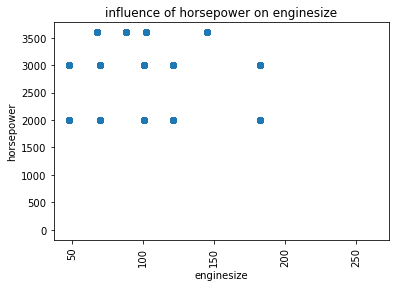

In [81]:
#Generating visualizations

#Scatter plot of horsepower (flat file) vs Engine_Capacity (website)

plt.scatter(sql5['horsepower'], sql5['Engine_Capacity'])
plt.xlabel('enginesize')
plt.ylabel('horsepower')
plt.title('influence of horsepower on enginesize')
plt.xticks(fontsize = 10, rotation = 90)
plt.show()

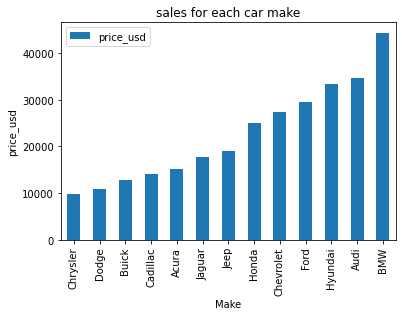

In [82]:
    #Bar chart of average car Price (API) for each car make (flat file)

#Grabbing a query of the car data ordered by wheelbase, then deleting the columns I don't need from the query
q5 = pd.read_sql('SELECT * FROM Car_summary ORDER BY price_usd', conn)


#Generating the bar chart and ordering the wheelbases


ordered = q5.groupby(['Make']).mean().sort_values(by = ['price_usd'])
ordered.plot.bar(y = 'price_usd')
plt.ylabel('price_usd')
plt.title('sales for each car make')
plt.show()

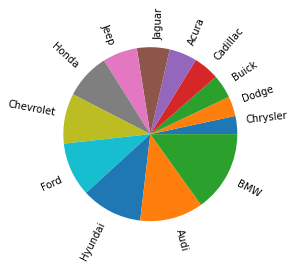

In [83]:
#Viewing the sales (website) for each make (flat file) as a pie chart

grouped = q5.groupby('Make').mean().sort_values(by = 'price_usd')
plt.pie(grouped['price_usd'].sort_values(), labels = grouped['price_usd'].sort_values().index, rotatelabels = True)
plt.show()

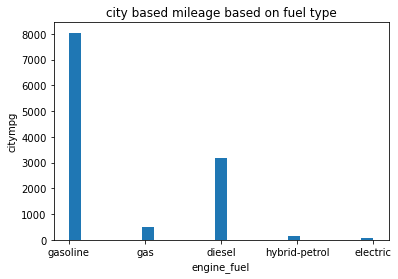

In [84]:
# vewing Histogram of 'engine_fuel (API) vs citympg (flatfile)

plt.hist(q5['engine_fuel'], bins = 25)
plt.xlabel('engine_fuel')
plt.ylabel('citympg')
plt.title('city based mileage based on fuel type')
plt.show()

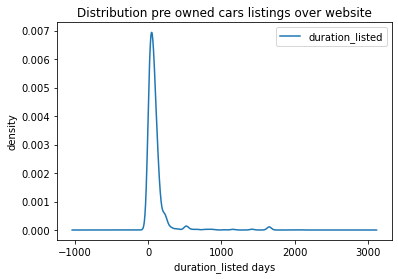

In [85]:

#Density plot of duration_listed (flat file)

q5.plot.density(y = 'duration_listed')
plt.xlabel('duration_listed days')
plt.ylabel('density')
plt.title('Distribution pre owned cars listings over website')
plt.show()

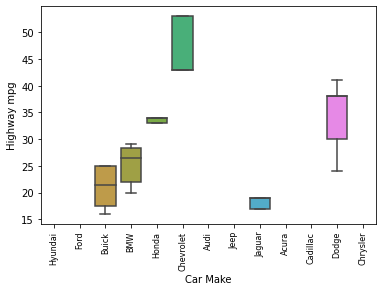

In [92]:
#Boxplots of the Highway mpg distribution (flat file) for each car make (flat file)

order1 = q5.groupby("Make").median().sort_values(by = ["odometer_value"], ascending = True).index
q5['highwaympg'] = q5['highwaympg'].astype('float')

p5 = sns.boxplot(x = 'Make', y = 'highwaympg', data = q5, order = order1, showfliers = False)
p5.set(xlabel = "Car Make", ylabel = "Highway mpg")
p5.set_xticklabels(p5.get_xticklabels(), rotation = 90, fontsize = 8)
plt.show()

## ***********************End of Project Milestone5********************************